Module 6 Assignment
Written by : Shivi Jain, Naina Gupta
Description: New York Crime Report - 2023 Data Analysis


In [45]:
# import required library
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import numpy as np
from sklearn.preprocessing import LabelEncoder
# to import the py file created for the prediction models
import prediction_models as pm

# Get the data from URL
url = "https://data.cityofnewyork.us/api/views/5uac-w243/rows.csv?accessType=DOWNLOAD"

#Link to the data set :  https://data.cityofnewyork.us/Public-Safety/NYPD-Complaint-Data-Current-Year-To-Date-/5uac-w243

df = pd.read_csv(url)

print(df.head())

  CMPLNT_NUM  ADDR_PCT_CD        BORO_NM CMPLNT_FR_DT CMPLNT_FR_TM  \
0  261548672         43.0          BRONX   01/07/2023     21:30:00   
1  265065361         69.0       BROOKLYN   06/12/2022     01:55:00   
2  262612530        110.0         QUEENS   09/09/2022     00:55:00   
3  261233867        123.0  STATEN ISLAND   01/02/2023     02:00:00   
4  264778583         30.0      MANHATTAN   06/29/2021     21:00:00   

  CMPLNT_TO_DT CMPLNT_TO_TM CRM_ATPT_CPTD_CD HADEVELOPT  HOUSING_PSA  ...  \
0          NaN       (null)        COMPLETED     (null)          NaN  ...   
1          NaN       (null)        COMPLETED     (null)          NaN  ...   
2   09/09/2022     01:19:00        COMPLETED     (null)          NaN  ...   
3   01/02/2023     02:10:00        COMPLETED     (null)          NaN  ...   
4   06/29/2021     21:30:00        COMPLETED     (null)          NaN  ...   

   TRANSIT_DISTRICT VIC_AGE_GROUP        VIC_RACE VIC_SEX X_COORD_CD  \
0               NaN       UNKNOWN         UN

In [46]:
# Dataframe structure
print('\n Dataframe has', df.shape, 'rows and columns respectively')


 Dataframe has (130199, 36) rows and columns respectively


### Data Cleaning and Preperation

In [47]:
# 1. Remove unwanted columns from the dataframe
data = df.drop(columns=['HADEVELOPT', 'PARKS_NM',
                        'PD_CD', 'JURIS_DESC',
                        'TRANSIT_DISTRICT', 'STATION_NAME',
                        'Lat_Lon',
                        'JURISDICTION_CODE', 'New Georeferenced Column',
                        'X_COORD_CD', 'Y_COORD_CD'])

In [48]:
# 2. Check for null values and process them
#check null values
data.isnull()

#check data info 
print(data.info())

#replace empty cells
data["ADDR_PCT_CD"].fillna(0, inplace = True)
data["HOUSING_PSA"].fillna(0, inplace = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 130199 entries, 0 to 130198
Data columns (total 25 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   CMPLNT_NUM         130199 non-null  object 
 1   ADDR_PCT_CD        130185 non-null  float64
 2   BORO_NM            130199 non-null  object 
 3   CMPLNT_FR_DT       130199 non-null  object 
 4   CMPLNT_FR_TM       130199 non-null  object 
 5   CMPLNT_TO_DT       121143 non-null  object 
 6   CMPLNT_TO_TM       130199 non-null  object 
 7   CRM_ATPT_CPTD_CD   130199 non-null  object 
 8   HOUSING_PSA        8781 non-null    float64
 9   KY_CD              130199 non-null  int64  
 10  LAW_CAT_CD         130199 non-null  object 
 11  LOC_OF_OCCUR_DESC  130199 non-null  object 
 12  OFNS_DESC          130199 non-null  object 
 13  PATROL_BORO        130199 non-null  object 
 14  PD_DESC            130199 non-null  object 
 15  PREM_TYP_DESC      130199 non-null  object 
 16  RP

In [49]:
# 3. Change the field to the correct datatype and filter the data for the year 2023
data['CMPLNT_TO_DT'] = pd.to_datetime(data['CMPLNT_TO_DT'],errors='coerce')
data = data[(data['CMPLNT_TO_DT'] >= '2023-01-01')]

# create the columns for DayofWeek , Month and Date for the date column
data['CMPLNT_TO_DFW'] = data['CMPLNT_TO_DT'].dt.day_name()
data['CMPLNT_TO_MONTH'] = data['CMPLNT_TO_DT'].dt.strftime('%B')
data['CMPLNT_TO_DT'] = data['CMPLNT_TO_DT'].dt.date

data['RPT_DT'] = pd.to_datetime(data['RPT_DT'],errors='coerce')
data['RPT_DFW'] = data['RPT_DT'].dt.day_name()
data['RPT_DT'] = data['RPT_DT'].dt.date

In [50]:
# 4. Removing minutes and hours from the time column to use it in vizulaization
data['CMPLNT_FR_TM'] = data['CMPLNT_FR_TM'].map(lambda x: pd.to_datetime(x).strftime('%H'))

# 5. Replace the (null) values in time column with zero hours
data['CMPLNT_TO_TM'] = data['CMPLNT_TO_TM'].replace('(null)',"00:00:00")
data['CMPLNT_TO_TM'] = data['CMPLNT_TO_TM'].map(lambda x: pd.to_datetime(x).strftime('%H'))

In [51]:
# 6. Replace null values in suspect gender with Unknown
data['SUSP_SEX'] = data['SUSP_SEX'].replace('(null)',"U")

pm.replace_null_with_unknown(data) #used the function to remove the '(null)' values with 'UNKNOWN'


,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HOUSING_PSA,KY_CD,...,SUSP_RACE,SUSP_SEX,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,Latitude,Longitude,CMPLNT_TO_DFW,CMPLNT_TO_MONTH,RPT_DFW
3,261233867,123.0,STATEN ISLAND,01/02/2023,02,2023-01-02,02,COMPLETED,0.0,341,...,UNKNOWN,U,45-64,WHITE,F,40.510063,-74.240524,Monday,January,Monday
5,261496066,103.0,QUEENS,01/05/2022,23,2023-01-06,10,COMPLETED,0.0,351,...,UNKNOWN,U,25-44,BLACK,M,40.701238,-73.794641,Friday,January,Friday
7,261307784,115.0,QUEENS,01/03/2023,16,2023-01-03,16,COMPLETED,0.0,341,...,WHITE,M,UNKNOWN,UNKNOWN,D,40.758598,-73.892069,Tuesday,January,Tuesday
10,261249686,67.0,BROOKLYN,01/01/2023,16,2023-01-02,11,COMPLETED,0.0,233,...,BLACK,M,25-44,BLACK,F,40.648851,-73.951017,Monday,January,Monday
11,261476719,105.0,QUEENS,12/24/2022,12,2023-01-06,07,COMPLETED,0.0,107,...,UNKNOWN,U,25-44,UNKNOWN,M,40.741496,-73.721665,Friday,January,Friday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130193,265984434,48.0,BRONX,03/30/2023,14,2023-03-30,14,COMPLETED,0.0,578,...,WHITE HISPANIC,M,<18,WHITE HISPANIC,F,40.860745,-73.889581,Thursday,March,Friday
130195,265988197,1.0,MANHATTAN,03/31/2023,22,2023-03-31,22,COMPLETED,0.0,578,...,BLACK,F,25-44,WHITE,M,40.710887,-74.009061,Friday,March,Friday
130196,265966526,7.0,MANHATTAN,03/31/2023,03,2023-03-31,03,COMPLETED,0.0,341,...,WHITE,M,UNKNOWN,UNKNOWN,D,40.718009,-73.989853,Friday,March,Friday
130197,265958921,48.0,BRONX,03/31/2023,08,2023-03-31,08,COMPLETED,0.0,344,...,WHITE HISPANIC,F,25-44,WHITE HISPANIC,M,40.844238,-73.877673,Friday,March,Friday


In [52]:
# 7. Rename the columns
data= data.rename(columns={'Latitude':'LATITUDE', 
                           'Longitude':'LONGITUDE'})

In [53]:
# 8. Transform Age group of the suspect and the victim in the correct age group label
data['SUSP_AGE_LAB'] = data['SUSP_AGE_GROUP'].apply(lambda age: pm.get_age_label(age))
data['VIC_AGE_LAB'] = data['VIC_AGE_GROUP'].apply(lambda age: pm.get_age_label(age))


In [54]:
# 9. Transform Age group of the suspect
data['SUSP_AGE'] = data.SUSP_AGE_GROUP.str.extract(r'(?<=-)(\d+)')
# Converting the extracted values to numeric type
data['SUSP_AGE'] = pd.to_numeric(data['SUSP_AGE'], errors='coerce')

# Filling missing values with the mean age group
mean_age_group = np.mean(data['SUSP_AGE'])
data['SUSP_AGE'] = data['SUSP_AGE'].apply(lambda x: mean_age_group if x < 0 or x > 100 else x)
data['SUSP_AGE'] = data['SUSP_AGE'].fillna(int(mean_age_group))

data['VIC_AGE'] = data.VIC_AGE_GROUP.str.extract(r'(?<=-)(\d+)')
# Converting the extracted values to numeric type
data['VIC_AGE'] = pd.to_numeric(data['VIC_AGE'], errors='coerce')

# Filling missing values with the mean age group
mean_age_group = np.mean(data['VIC_AGE'])
data['VIC_AGE'] = data['VIC_AGE'].apply(lambda x: mean_age_group if x < 0 or x > 100 else x)
data['VIC_AGE'] = data['VIC_AGE'].fillna(int(mean_age_group))

In [55]:
# Display the data after transformation
print(df.columns)
print(df.head())

Index(['CMPLNT_NUM', 'ADDR_PCT_CD', 'BORO_NM', 'CMPLNT_FR_DT', 'CMPLNT_FR_TM',
       'CMPLNT_TO_DT', 'CMPLNT_TO_TM', 'CRM_ATPT_CPTD_CD', 'HADEVELOPT',
       'HOUSING_PSA', 'JURISDICTION_CODE', 'JURIS_DESC', 'KY_CD', 'LAW_CAT_CD',
       'LOC_OF_OCCUR_DESC', 'OFNS_DESC', 'PARKS_NM', 'PATROL_BORO', 'PD_CD',
       'PD_DESC', 'PREM_TYP_DESC', 'RPT_DT', 'STATION_NAME', 'SUSP_AGE_GROUP',
       'SUSP_RACE', 'SUSP_SEX', 'TRANSIT_DISTRICT', 'VIC_AGE_GROUP',
       'VIC_RACE', 'VIC_SEX', 'X_COORD_CD', 'Y_COORD_CD', 'Latitude',
       'Longitude', 'Lat_Lon', 'New Georeferenced Column'],
      dtype='object')
  CMPLNT_NUM  ADDR_PCT_CD        BORO_NM CMPLNT_FR_DT CMPLNT_FR_TM  \
0  261548672         43.0          BRONX   01/07/2023     21:30:00   
1  265065361         69.0       BROOKLYN   06/12/2022     01:55:00   
2  262612530        110.0         QUEENS   09/09/2022     00:55:00   
3  261233867        123.0  STATEN ISLAND   01/02/2023     02:00:00   
4  264778583         30.0      MANHATTAN 

In [56]:
# Data discription
data_description = data.describe()
print(data_description)

         ADDR_PCT_CD    HOUSING_PSA          KY_CD       LATITUDE  \
count  117319.000000  117319.000000  117319.000000  117319.000000   
mean       64.641175     445.169171     301.244658      40.733061   
std        35.316425    3863.265807     158.640131       0.143689   
min         1.000000       0.000000     103.000000       0.000000   
25%        40.000000       0.000000     117.000000      40.673924   
50%        67.000000       0.000000     341.000000      40.731296   
75%       102.000000       0.000000     351.000000      40.804008   
max       123.000000   64443.000000     881.000000      40.912714   

           LONGITUDE       SUSP_AGE        VIC_AGE  
count  117319.000000  117319.000000  117319.000000  
mean      -73.923217      45.000605      47.241537  
std         0.229461       8.190268       9.894220  
min       -74.254377       5.000000       2.000000  
25%       -73.974266      44.000000      44.000000  
50%       -73.927353      45.000000      47.000000  
75%    

### Data Visualization

In [57]:
# 1. Density Map for the crime reported

fig = px.density_mapbox(data, lat='LATITUDE', lon='LONGITUDE', radius=1, zoom=9, mapbox_style="stamen-terrain",
                        hover_data={'LATITUDE': True, 'LONGITUDE': True, 'BORO_NM': True})
fig.update_layout(hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"))

fig.show()


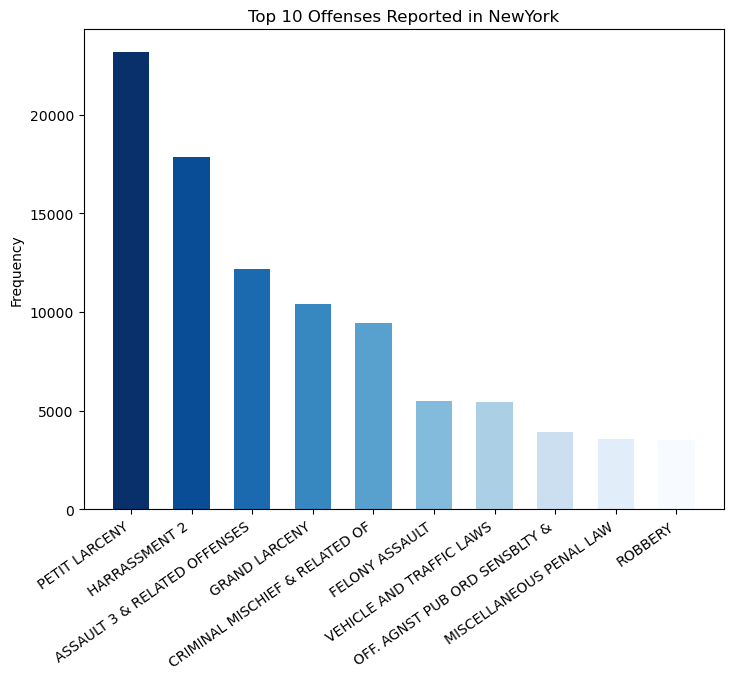

In [58]:
# 2. What are the top 10 offenses reported in New York in 2023?
topOffense = data.groupby('OFNS_DESC').size().nlargest(10)

# Generate a sequence of 10 colors in shades of blue
colors = cm.Blues_r(np.linspace(0, 1, len(topOffense)))

fig1 = plt.figure()
ax = fig1.add_axes([0,0,1,1])
plt.bar(topOffense.keys(),
        topOffense.values,
        width = 0.6,
        color = colors)
        
plt.ylabel('Offense')
plt.ylabel('Frequency')
plt.title('Top 10 Offenses Reported in NewYork')
plt.xticks(rotation=35, ha='right')
plt.show()

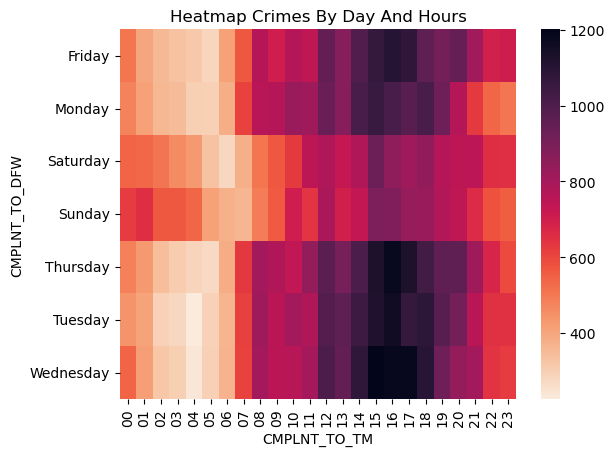

In [59]:
# 3. Crime Distribution in each hours of Days?
# Group the data by day of the week and hour of the day, and count the number of occurrences
#grouped_data = data.groupby(['CMPLNT_FR_DFW', 'CMPLNT_TO_TM']).count()
crimesByDaysOfWeekAndHours = data.groupby(['CMPLNT_TO_DFW', 'CMPLNT_TO_TM']).size().reset_index()
crimesByDaysOfWeekAndHours.columns = ['CMPLNT_TO_DFW', 'CMPLNT_TO_TM', 'COUNT']
crimesByDayAndHour = crimesByDaysOfWeekAndHours.pivot('CMPLNT_TO_DFW', 'CMPLNT_TO_TM', 'COUNT')
ax = sns.heatmap(crimesByDayAndHour, cmap = sns.cm.rocket_r)
plt.title("Heatmap Crimes By Day And Hours")
plt.show()

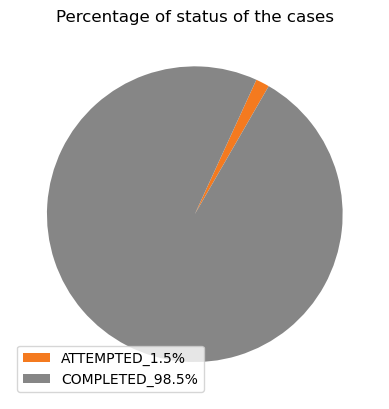

In [60]:
# 4. What is the overall percentage of crimes that have been solved?
case_status = data.groupby('CRM_ATPT_CPTD_CD', as_index = False)['CMPLNT_NUM'].count()
case_status['Percentage'] = (case_status['CMPLNT_NUM'] / case_status['CMPLNT_NUM'].sum()) * 100
case_status['Percentage'] = round(case_status['Percentage'],1)

# Set colors
colors = ['#F47A1F', '#868686']

labels = case_status['CRM_ATPT_CPTD_CD']+ "_" + case_status['Percentage'].astype(str)+'%'
plt.pie(case_status['Percentage'], shadow=False, startangle=60, colors=colors)
plt.legend(labels, loc="lower left")
plt.title('Percentage of status of the cases')
plt.show()

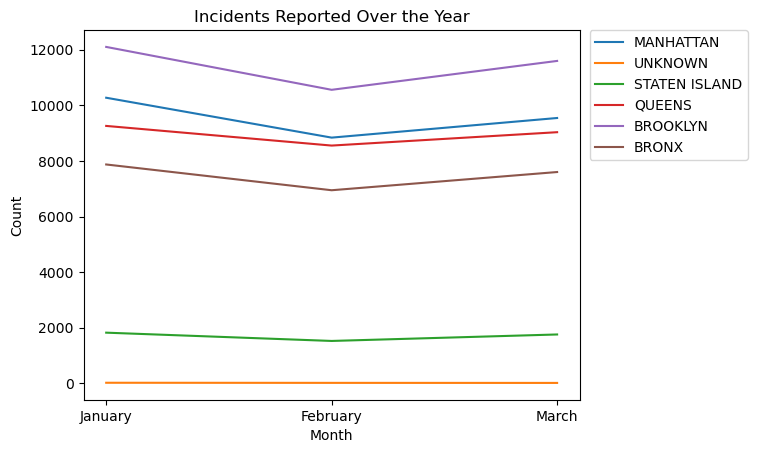

In [61]:
# 5. What is the trend of the incidents reported over the time period of the whole year?
crimesByMonth = data.groupby(['CMPLNT_TO_MONTH', 'BORO_NM']).size().reset_index()
crimesByMonth.columns = ['CMPLNT_TO_MONTH', 'BORO_NM', 'COUNT']
# Order the month column using pd.Categorical and sort the dataframe by it
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 
               'July', 'August', 'September', 'October', 'November', 'December']
crimesByMonth['CMPLNT_TO_MONTH'] = pd.Categorical(crimesByMonth['CMPLNT_TO_MONTH'], categories=month_order, ordered=True)
crimesByMonth = crimesByMonth.sort_values('CMPLNT_TO_MONTH')

# Plot the data
g = sns.lineplot(data=crimesByMonth, x='CMPLNT_TO_MONTH', y='COUNT', hue='BORO_NM').set(
    title='Incidents Reported Over the Year',
    xlabel='Month', ylabel='Count')

# Put the legend to the right side
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.show()

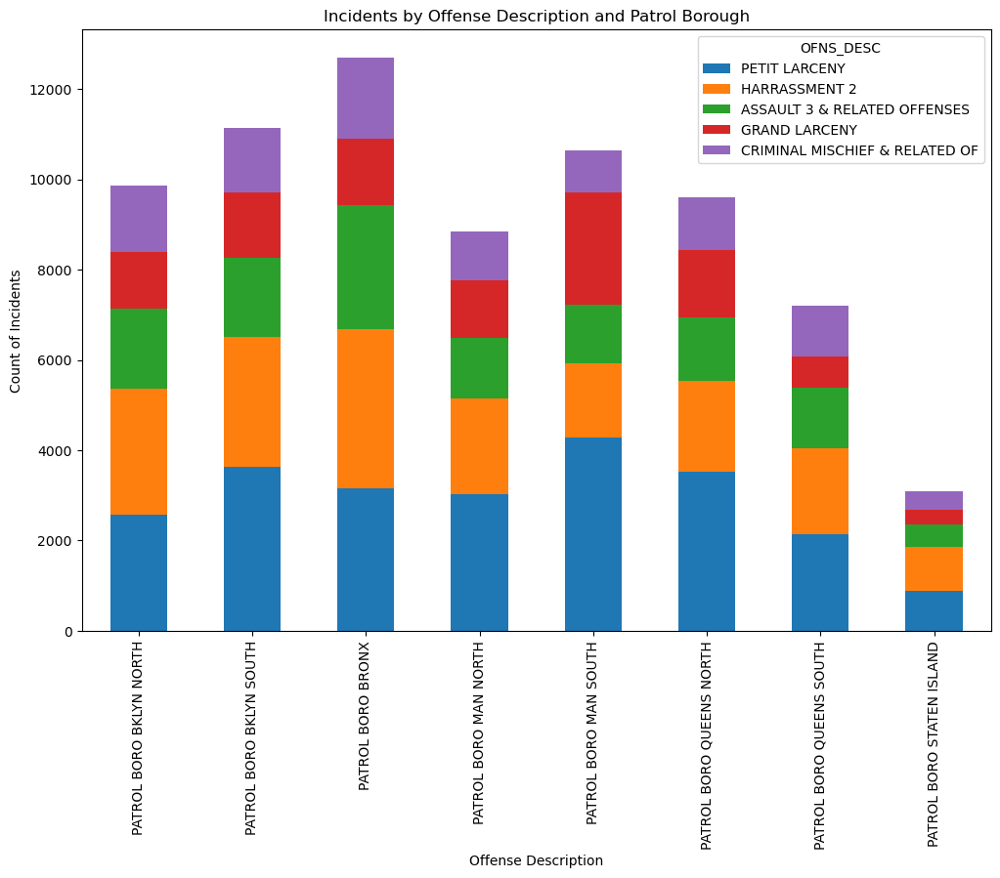

In [62]:
# 6. Stacked bar graph for the Petrolling boro and crime 
# Group the data by OFNS_DESC and PATROL_BORO, and count the incidents
grouped_data = data.groupby([ 'PATROL_BORO','OFNS_DESC'])['CMPLNT_NUM'].count().reset_index()

# Get the top 5 OFNS_DESC categories by incident count
top_ofns_desc = grouped_data.groupby('OFNS_DESC')['CMPLNT_NUM'].sum().sort_values(ascending=False).head(5).index

# Filter the data to include only the top 5 OFNS_DESC categories
filtered_data = grouped_data[grouped_data['OFNS_DESC'].isin(top_ofns_desc)]

# Pivot the data to create a table with OFNS_DESC as rows, PATROL_BORO as columns, and incident count as values
pivoted_data = filtered_data.pivot(index='PATROL_BORO', columns='OFNS_DESC', values='CMPLNT_NUM')

# Sort the columns in descending order of total incident count
pivoted_data = pivoted_data[pivoted_data.sum().sort_values(ascending=False).index]

# Plot the stacked bar chart
pivoted_data.plot(kind='bar', stacked=True, figsize=(12, 8))

# Add labels and title
plt.xlabel('Offense Description')
plt.ylabel('Count of Incidents')
plt.title('Incidents by Offense Description and Patrol Borough')

# Show the chart
plt.show()

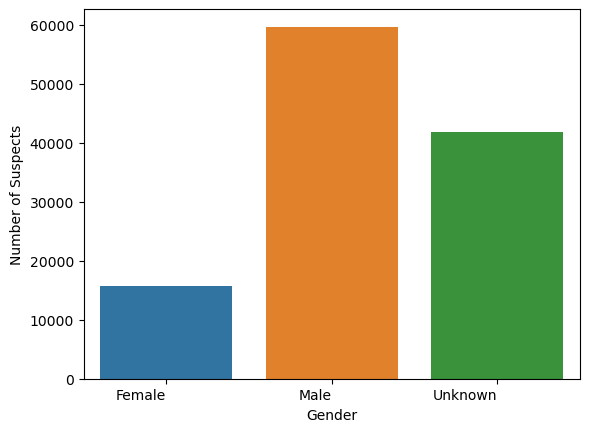

In [63]:
# 7. barplot for gender of suspects
d_1 = data.groupby('SUSP_SEX', as_index = False)['SUSP_SEX'].size()
gender = ['Female', 'Male', 'Unknown']
d_1.insert(2,"Gender", ['Female', 'Male', 'Unknown'])

sns.barplot(x = 'Gender',
            y = 'size',
            data = d_1)
plt.title('')
plt.xticks(rotation=0, ha='right')
plt.xlabel('Gender')
plt.ylabel('Number of Suspects')
plt.show()

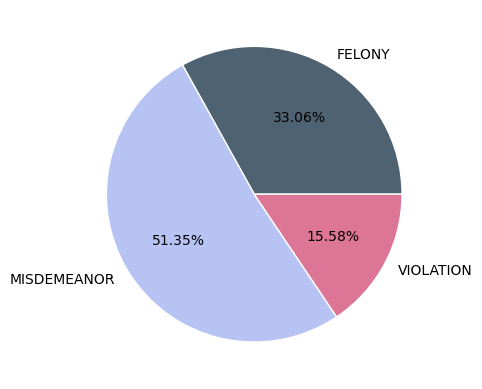

In [64]:
# 8. pie chart
d_3 = data.groupby('LAW_CAT_CD', as_index=False)['LAW_CAT_CD'].size()
d_3['Percentage'] = (d_3['size'] / d_3['size'].sum()) * 100

y = np.array(d_3['size'])
mylabels = ["FELONY", "MISDEMEANOR", "VIOLATION"]
myexplode = [0, 0, 0]
colors = ['#4F6272', '#B7C3F3', '#DD7596', '#8EB897']
plt.pie(y, labels = mylabels, explode = myexplode, wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white' }, colors=colors,
       autopct=lambda pct: f'{pct:.2f}%')
plt.show() 

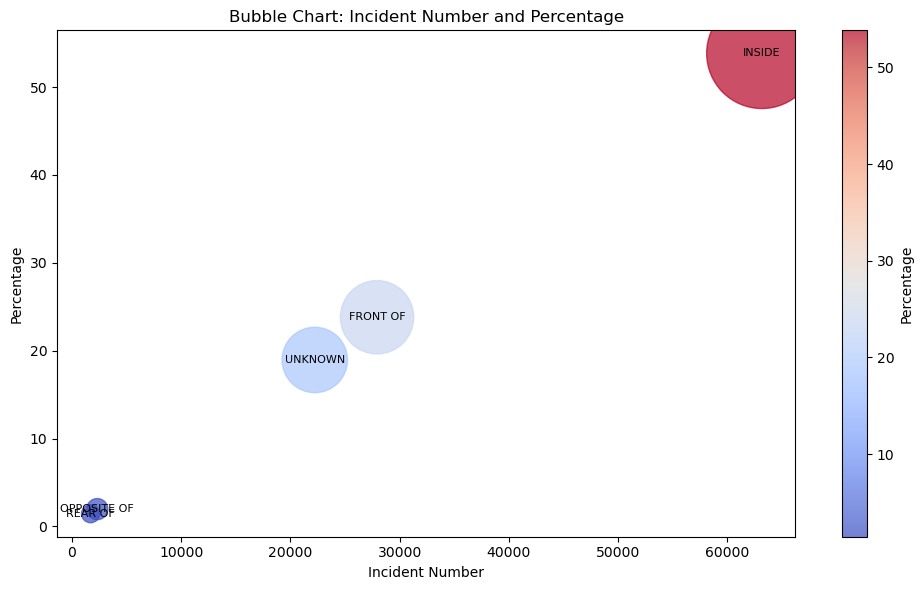

In [65]:
# 9. bubble chart

# Calculate the count and percentage for each category
incident_numbers = data.groupby('LOC_OF_OCCUR_DESC')['CMPLNT_NUM'].count().reset_index()
incident_numbers['percentages'] = (incident_numbers['CMPLNT_NUM'] / incident_numbers['CMPLNT_NUM'].sum()) * 100

# Set marker size based on incident number
marker_size = incident_numbers['CMPLNT_NUM'] * 0.1  # Adjust the scaling factor (0.1) as needed

# Set bubble color based on the percentage
bubble_color = incident_numbers['percentages']  # Use the percentages column as the color values

# Create the bubble chart with gradient color
plt.figure(figsize=(10, 6))
plt.scatter(incident_numbers['CMPLNT_NUM'], incident_numbers['percentages'], s=marker_size, c=bubble_color, alpha=0.7, cmap='coolwarm')

# Add labels for each location
for i, row in incident_numbers.iterrows():
    plt.text(row['CMPLNT_NUM'], row['percentages'], row['LOC_OF_OCCUR_DESC'], ha='center', va='center', fontsize=8)

# Set axis labels and title
plt.xlabel('Incident Number')
plt.ylabel('Percentage')
plt.title('Bubble Chart: Incident Number and Percentage')

# Add a colorbar
plt.colorbar(label='Percentage')

# Show the plot
plt.tight_layout()
plt.show()

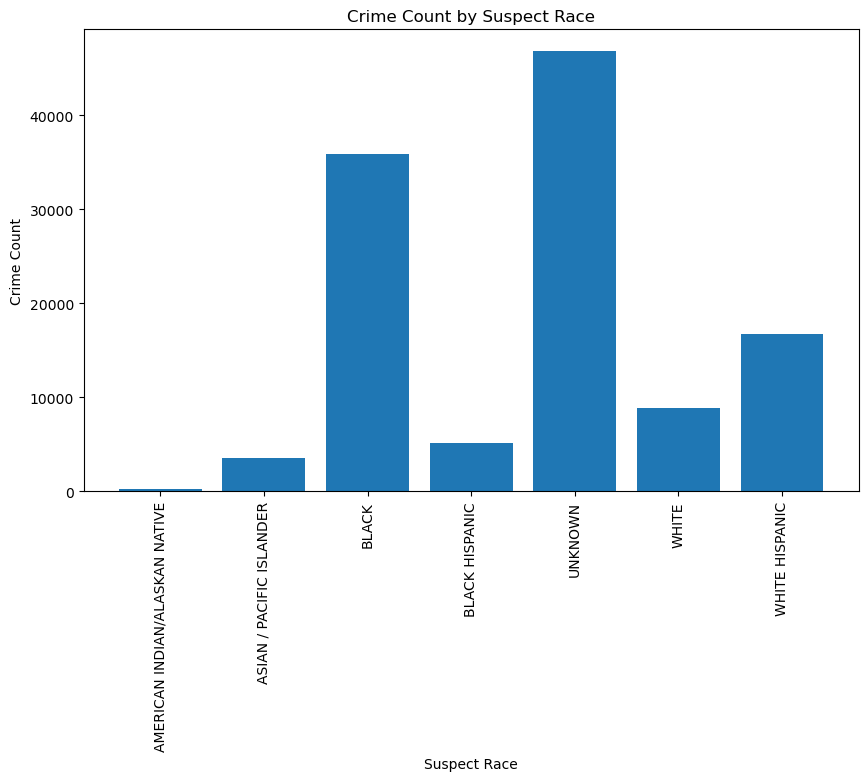

In [66]:
# 10. Bar plot for the count of crimes by Race of the suspect
percent_counts = data.groupby('SUSP_RACE')['CMPLNT_NUM'].count().reset_index()

plt.figure(figsize=(10, 6))
plt.bar(percent_counts['SUSP_RACE'], percent_counts['CMPLNT_NUM'])
plt.xlabel('Suspect Race')
plt.ylabel('Crime Count')
plt.title('Crime Count by Suspect Race')
plt.xticks(rotation=90)
plt.show()

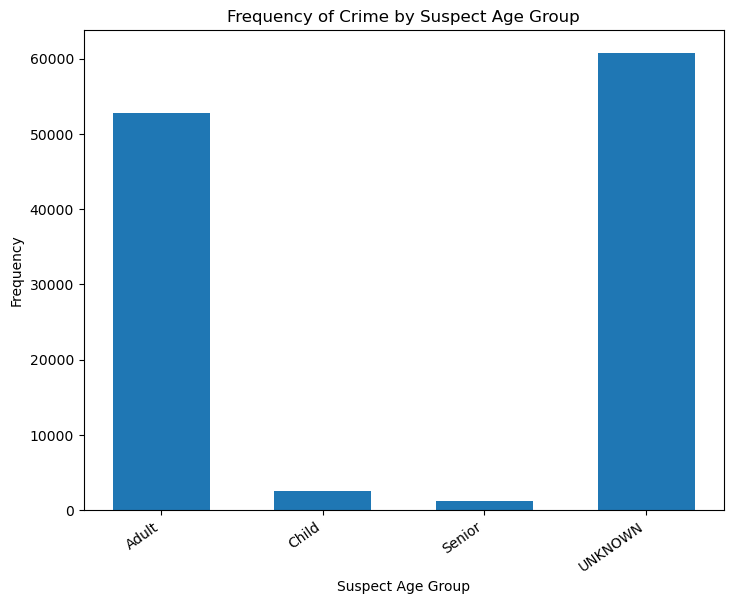

In [67]:
#11. Bar plot for by suspect age label
count_of_age_group = data.groupby('SUSP_AGE_LAB').size()

fig2 = plt.figure()
ax = fig2.add_axes([0,0,1,1])
plt.bar(count_of_age_group.keys(),
        count_of_age_group.values,
        width = 0.6)
        
plt.xlabel('Suspect Age Group')
plt.ylabel('Frequency')
plt.title('Frequency of Crime by Suspect Age Group')
plt.xticks(rotation=35, ha='right')
plt.show()

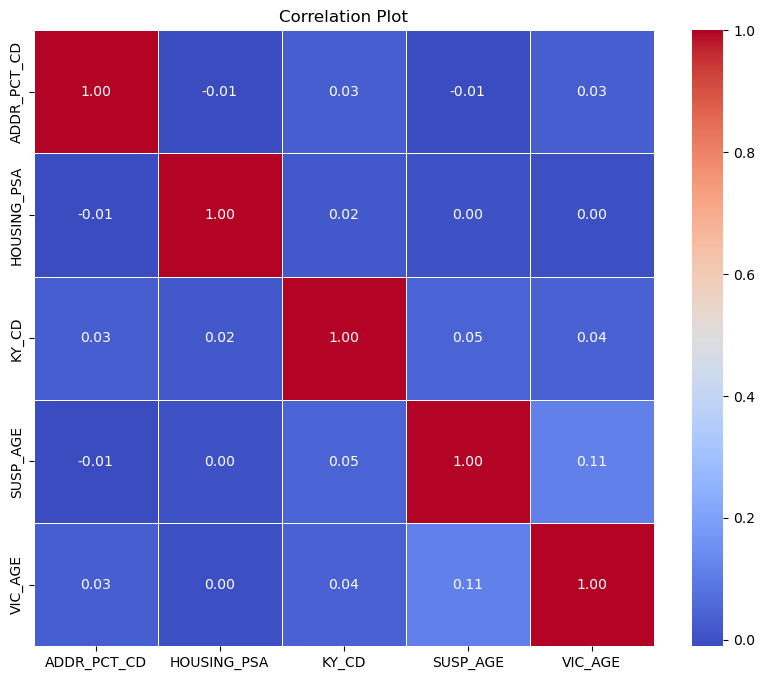

In [68]:
# Corrplot
# Calculate the correlation matrix
# Remove columns you want to exclude
columns_to_exclude = ['LATITUDE','LONGITUDE']
data_subset = data.drop(columns_to_exclude, axis=1)

# Calculate the correlation matrix
corr_matrix = data_subset.corr()

# Create a correlation plot (heatmap)
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Plot')
plt.show()

### Prediction Model

Training data shape: (93855, 3)
Testing data shape: (23464, 3)
Training data statistics:
         LAW_CAT_CD  SUSP_AGE_LAB     SUSP_RACE
count  93855.000000  93855.000000  93855.000000
mean       0.824964      1.596590      3.601556
std        0.675712      1.475307      1.435265
min        0.000000      0.000000      0.000000
25%        0.000000      0.000000      2.000000
50%        1.000000      3.000000      4.000000
75%        1.000000      3.000000      4.000000
max        2.000000      3.000000      6.000000
Testing data statistics:
         LAW_CAT_CD  SUSP_AGE_LAB     SUSP_RACE
count  23464.000000  23464.000000  23464.000000
mean       0.826117      1.589840      3.623125
std        0.673237      1.476587      1.447048
min        0.000000      0.000000      0.000000
25%        0.000000      0.000000      2.000000
50%        1.000000      3.000000      4.000000
75%        1.000000      3.000000      4.000000
max        2.000000      3.000000      6.000000

 Accuracy of this Mod

array([2, 2, 1, ..., 1, 1, 1])

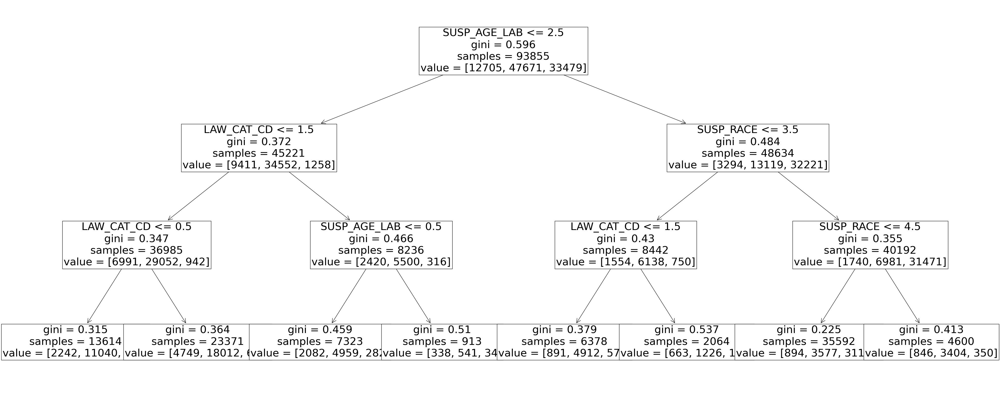

In [69]:
#---------Decision Tree Model---------------#
selected_columns = ['LAW_CAT_CD', 'SUSP_AGE_LAB', 'SUSP_SEX','SUSP_RACE']
data_1 = data[selected_columns].dropna()

# Encode categorical variables
label_encoder = LabelEncoder()
data_1['LAW_CAT_CD'] = label_encoder.fit_transform(data_1['LAW_CAT_CD'])
data_1['SUSP_AGE_LAB'] = label_encoder.fit_transform(data_1['SUSP_AGE_LAB'])
data_1['SUSP_SEX'] = label_encoder.fit_transform(data_1['SUSP_SEX'])
data_1['SUSP_RACE'] = label_encoder.fit_transform(data_1['SUSP_RACE'])

# Call method for Decision Tree Classifier prediction model
pm.decisiontree_model(data_1)


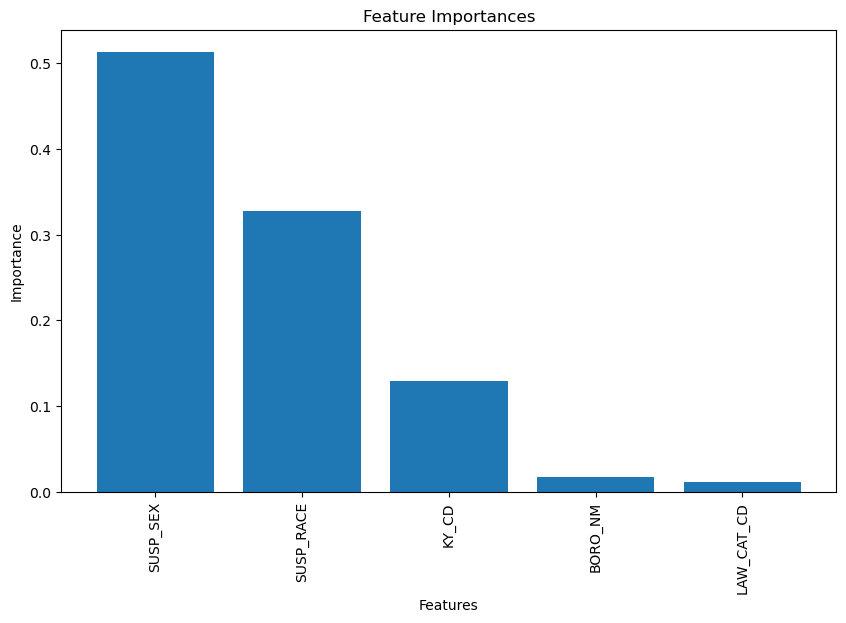

Training data shape: (93855, 5)
Testing data shape: (23464, 5)
Training data statistics:
              KY_CD       BORO_NM      SUSP_SEX     SUSP_RACE    LAW_CAT_CD
count  93855.000000  93855.000000  93855.000000  93855.000000  93855.000000
mean      29.788876      1.641287      1.221341      3.601556      0.824964
std       17.924901      1.154865      0.665651      1.435265      0.675712
min        0.000000      0.000000      0.000000      0.000000      0.000000
25%       13.000000      1.000000      1.000000      2.000000      0.000000
50%       32.000000      2.000000      1.000000      4.000000      1.000000
75%       42.000000      3.000000      2.000000      4.000000      1.000000
max       60.000000      5.000000      2.000000      6.000000      2.000000
Testing data statistics:
              KY_CD       BORO_NM      SUSP_SEX     SUSP_RACE    LAW_CAT_CD
count  23464.000000  23464.000000  23464.000000  23464.000000  23464.000000
mean      29.831146      1.648909      1.222937   

array([3, 3, 0, ..., 0, 0, 0])

In [70]:
#-----------RandomForest Prediction model-------------------#
selected_predictors = ['BORO_NM', 'SUSP_AGE_LAB', 'SUSP_SEX', 'SUSP_RACE', 'LAW_CAT_CD', 'KY_CD']
data_2 = data[selected_predictors].dropna()

# Encode categorical variables
label_encoder = LabelEncoder()

data_2['BORO_NM'] = label_encoder.fit_transform(data_2['BORO_NM'])
data_2['SUSP_AGE_LAB'] = label_encoder.fit_transform(data_2['SUSP_AGE_LAB'])
data_2['SUSP_SEX'] = label_encoder.fit_transform(data_2['SUSP_SEX'])
data_2['SUSP_RACE'] = label_encoder.fit_transform(data_2['SUSP_RACE'])
data_2['LAW_CAT_CD'] = label_encoder.fit_transform(data_2['LAW_CAT_CD'])
data_2['KY_CD'] = label_encoder.fit_transform(data_2['KY_CD'])

# Call method for Randon Forest prediction model
pm.randomforest_model(data_2)